# Data Exploration

#### In this notebook we explore the data set (https://www.kaggle.com/sohier/london-police-records?select=london-stop-and-search.csv).

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
import util
import util_smote
import seaborn as sns

In [2]:
data = pd.read_csv("data.csv")

# data = data.dropna()
data = util.data_cleaner(data)
data.info()


<class 'pandas.core.frame.DataFrame'>
Int64Index: 165651 entries, 0 to 302621
Data columns (total 10 columns):
 #   Column                     Non-Null Count   Dtype              
---  ------                     --------------   -----              
 0   Type                       165651 non-null  object             
 1   Date                       165651 non-null  datetime64[ns, UTC]
 2   Latitude                   165651 non-null  float64            
 3   Longitude                  165651 non-null  float64            
 4   Gender                     165651 non-null  object             
 5   Age range                  165651 non-null  object             
 6   Officer-defined ethnicity  165651 non-null  object             
 7   Legislation                165651 non-null  object             
 8   Object of search           165651 non-null  object             
 9   Outcome                    165651 non-null  object             
dtypes: datetime64[ns, UTC](1), float64(2), object(7)
memory 

In [3]:
data_encoded, encoders = util.data_encoder(data)
data_encoded.head()

,Type,Date,Latitude,Longitude,Gender,Age range,Officer-defined ethnicity,Legislation,Object of search,Outcome
0,1,0,51.512286,-0.114491,1,1,0,4,8,6
1,1,0,51.512286,-0.114491,1,1,0,4,8,6
2,1,1,51.512286,-0.114491,1,1,4,4,8,6
4,0,2,51.512286,-0.114491,1,1,4,4,8,6
5,1,3,51.512286,-0.114491,1,1,0,3,3,2


## Frequencies of Target Classes

Class 0: 0.02%     (41)
Class 1: 0.68%     (1121)
Class 2: 65.41%     (108353)
Class 3: 0.1%     (167)
Class 4: 10.74%     (17788)
Class 5: 2.31%     (3824)
Class 6: 19.96%     (33067)
Class 7: 0.78%     (1290)
Total: 165651


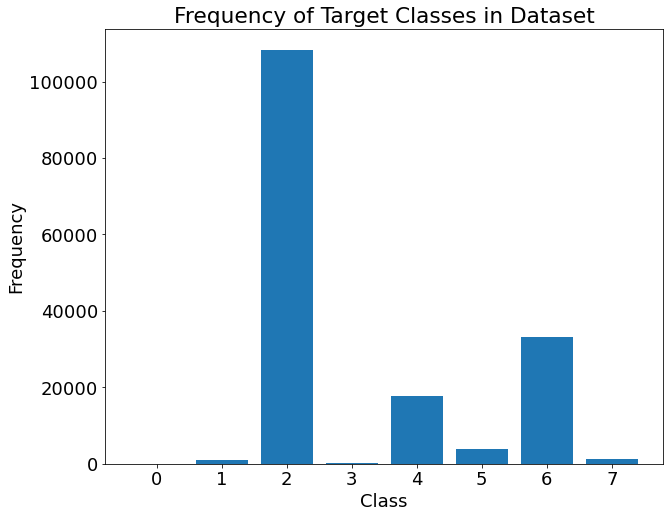

In [4]:
util_smote.display_frequencies(data_encoded["Outcome"])

Correlations of each feature to the target

## Visualizing the Dataset 

#### Latitude and Longitude to Outcome 

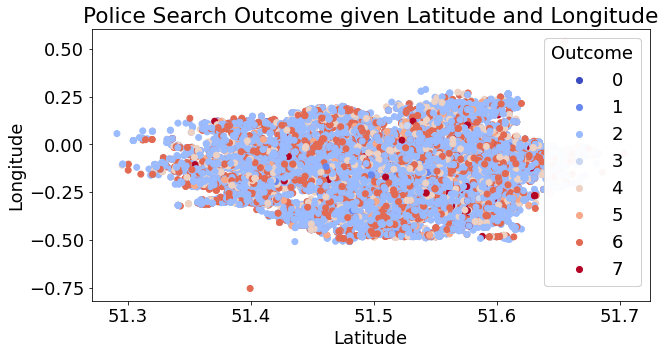

In [5]:
Latitude = data_encoded["Latitude"]
Longitude = data_encoded["Longitude"]

fig = plt.figure(figsize=[10, 5])
ax = fig.add_subplot()
scatter = ax.scatter(Latitude, Longitude, c=data_encoded["Outcome"], cmap=cm.coolwarm)
legend = ax.legend(*scatter.legend_elements(num=8), loc="upper right", title="Outcome")
ax.add_artist(legend)
plt.title("Police Search Outcome given Latitude and Longitude")
plt.xlabel("Latitude")
plt.ylabel("Longitude")

plt.show()

### Time

In [6]:
time = data["Date"]
print(time)

0        2015-03-02 16:40:00+00:00
1        2015-03-02 16:40:00+00:00
2        2015-03-02 18:45:00+00:00
4        2015-03-03 15:50:00+00:00
5        2015-03-03 20:20:00+00:00
                    ...           
302612   2017-04-30 21:49:00+00:00
302614   2017-04-30 21:50:00+00:00
302617   2017-04-30 22:05:00+00:00
302620   2017-04-30 22:25:00+00:00
302621   2017-04-30 22:35:00+00:00
Name: Date, Length: 165651, dtype: datetime64[ns, UTC]


## Seaborn Pair Plot

KeyboardInterrupt: 